$\Huge Computational$ $\Huge Intelligence$ $\Huge Lab$

$\Huge  Assignment$ $\Huge 6$
---
Tristan Malatyński gr. 1
---

# 6.1 Load IMDB reviews dataset

In [55]:
import tensorflow_datasets as tfds
import tensorflow as tf

ds_train = tfds.load('imdb_reviews', split='train', as_supervised=True, shuffle_files=False)
ds_test = tfds.load('imdb_reviews', split='test', as_supervised=True, shuffle_files=False)


Examine the content - we prefer texts and label values to tensors

In [56]:
import pandas as pd

df_train = pd.DataFrame(ds_train.take(10))
df_train.head()


,0,1
0,"tf.Tensor(b""This was an absolutely terrible mo...","tf.Tensor(0, shape=(), dtype=int64)"
1,tf.Tensor(b'I have been known to fall asleep d...,"tf.Tensor(0, shape=(), dtype=int64)"
2,tf.Tensor(b'Mann photographs the Alberta Rocky...,"tf.Tensor(0, shape=(), dtype=int64)"
3,tf.Tensor(b'This is the kind of film for a sno...,"tf.Tensor(1, shape=(), dtype=int64)"
4,"tf.Tensor(b'As others have mentioned, all the ...","tf.Tensor(1, shape=(), dtype=int64)"


In [57]:
data = [(text.numpy().decode('UTF8'),label.numpy()) for text,label in ds_train]
df_train = pd.DataFrame(data,columns=['text','label'])
df_train.head(len(df_train))


,text,label
0,This was an absolutely terrible movie. Don't b...,0
1,"I have been known to fall asleep during films,...",0
2,Mann photographs the Alberta Rocky Mountains i...,0
3,This is the kind of film for a snowy Sunday af...,1
4,"As others have mentioned, all the women that g...",1
...,...,...
24995,"I have a severe problem with this show, severa...",0
24996,"The year is 1964. Ernesto ""Che"" Guevara, havin...",1
24997,Okay. So I just got back. Before I start my re...,0
24998,When I saw this trailer on TV I was surprised....,0


How many labels and what is the class distribution?

array([[<Axes: title={'center': 'label'}>]], dtype=object)

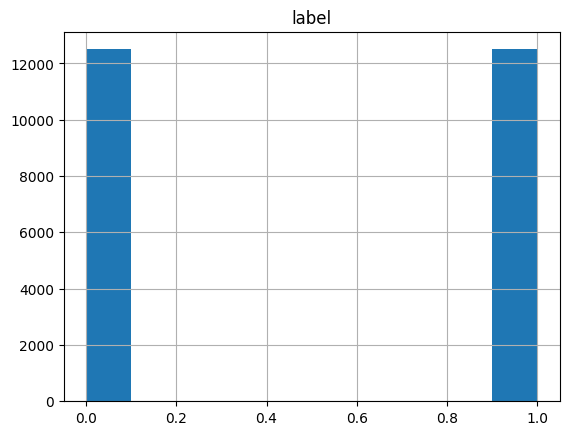

In [58]:
df_train.hist()

In [59]:
data = [(text.numpy().decode('UTF8'),label.numpy()) for text,label in ds_test]
df_test = pd.DataFrame(data,columns=['text','label'])
df_test.head(len(df_test))


,text,label
0,There are films that make careers. For George ...,1
1,"A blackly comic tale of a down-trodden priest,...",1
2,"Scary Movie 1-4, Epic Movie, Date Movie, Meet ...",0
3,Poor Shirley MacLaine tries hard to lend some ...,0
4,As a former Erasmus student I enjoyed this fil...,1
...,...,...
24995,"Feeling Minnesota is not really a road movie, ...",0
24996,"This is, without doubt, one of my favourite ho...",1
24997,Most predicable movie I've ever seen...extreme...,0
24998,It's exactly what I expected from it. Relaxing...,1


array([[<Axes: title={'center': 'label'}>]], dtype=object)

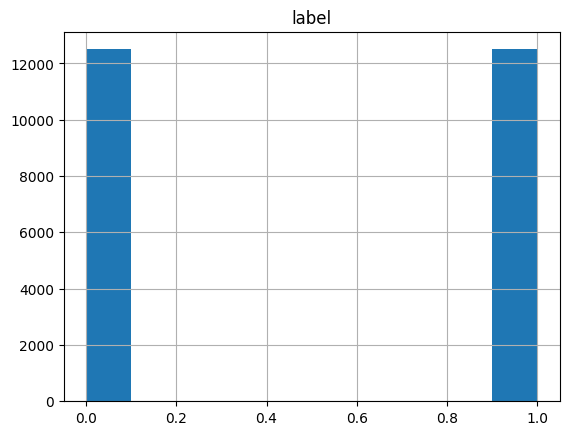

In [60]:
df_test.hist()

# 6.2 Text preprocessing

Text preprocessing involves
*  cleaning
*  extracting tokens (words, bigrams, trigrams, sometimes character based tokens)
*  counting tokens, converting documents to the bag-of-words representation
*  for frequency based representations: scaling
*  padding sequences in the case of neural networks



## CountVectorizer

In [61]:
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
import numpy as np

input = """Incy Wincy spider went up the water spout
Down came the rain and washed the spider out
Out came the sun and dried up all the rain
And the Incy Wincy spider went up the spout again
Incy Wincy spider went up the water spout
Down came the rain and washed the spider out
Out came the sun and dried up all the rain
And the Incy Wincy spider went up the spout again"""
corpus=input.split('\n')
print(corpus)

vectorizer = CountVectorizer()
vectorizer.fit(corpus)
X = vectorizer.transform(corpus)


['Incy Wincy spider went up the water spout', 'Down came the rain and washed the spider out', 'Out came the sun and dried up all the rain', 'And the Incy Wincy spider went up the spout again', 'Incy Wincy spider went up the water spout', 'Down came the rain and washed the spider out', 'Out came the sun and dried up all the rain', 'And the Incy Wincy spider went up the spout again']


What is X? Looks like a sparse matrix...

In [62]:
print(X.shape)
print(X)

(8, 18)
  (0, 6)	1
  (0, 9)	1
  (0, 10)	1
  (0, 12)	1
  (0, 13)	1
  (0, 15)	1
  (0, 16)	1
  (0, 17)	1
  (1, 2)	1
  (1, 3)	1
  (1, 4)	1
  (1, 7)	1
  (1, 8)	1
  (1, 9)	1
  (1, 12)	2
  (1, 14)	1
  (2, 1)	1
  (2, 2)	1
  (2, 3)	1
  (2, 5)	1
  (2, 7)	1
  (2, 8)	1
  (2, 11)	1
  (2, 12)	2
  (2, 13)	1
  :	:
  (5, 3)	1
  (5, 4)	1
  (5, 7)	1
  (5, 8)	1
  (5, 9)	1
  (5, 12)	2
  (5, 14)	1
  (6, 1)	1
  (6, 2)	1
  (6, 3)	1
  (6, 5)	1
  (6, 7)	1
  (6, 8)	1
  (6, 11)	1
  (6, 12)	2
  (6, 13)	1
  (7, 0)	1
  (7, 2)	1
  (7, 6)	1
  (7, 9)	1
  (7, 10)	1
  (7, 12)	2
  (7, 13)	1
  (7, 16)	1
  (7, 17)	1


In [63]:
Y=X.toarray()
print(Y)
print(vectorizer.vocabulary_)


[[0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 1 1]
 [0 0 1 1 1 0 0 1 1 1 0 0 2 0 1 0 0 0]
 [0 1 1 1 0 1 0 1 1 0 0 1 2 1 0 0 0 0]
 [1 0 1 0 0 0 1 0 0 1 1 0 2 1 0 0 1 1]
 [0 0 0 0 0 0 1 0 0 1 1 0 1 1 0 1 1 1]
 [0 0 1 1 1 0 0 1 1 1 0 0 2 0 1 0 0 0]
 [0 1 1 1 0 1 0 1 1 0 0 1 2 1 0 0 0 0]
 [1 0 1 0 0 0 1 0 0 1 1 0 2 1 0 0 1 1]]
{'incy': 6, 'wincy': 17, 'spider': 9, 'went': 16, 'up': 13, 'the': 12, 'water': 15, 'spout': 10, 'down': 4, 'came': 3, 'rain': 8, 'and': 2, 'washed': 14, 'out': 7, 'sun': 11, 'dried': 5, 'all': 1, 'again': 0}


## TF-IDF conversion

Tfidf - term frequency inverse document frequency assignes smaller weights to terms appering often in a set of documents. See [Wikipedia](https://en.wikipedia.org/wiki/Tf%E2%80%93idf)

$tf(t,d)=\frac{\#occurences\,of\, t\, in\, d}{sum\,of\,all\,term\,occurences}$

$idf(t,D)=log(\frac{number\,of\,documents}{number\,of\,documents\,containing\,term\,t})$

$tfidf(t,d,D)=tf(t,d)\cdot idf(t,D)$


In [64]:
transformer = TfidfTransformer()
Z = transformer.fit_transform(X).toarray()
print(Z)

[[0.         0.         0.         0.         0.         0.
  0.36796129 0.         0.         0.2899856  0.36796129 0.
  0.23174479 0.2899856  0.         0.48634247 0.36796129 0.36796129]
 [0.         0.         0.25810931 0.32751362 0.43288191 0.
  0.         0.32751362 0.32751362 0.25810931 0.         0.
  0.41254109 0.         0.43288191 0.         0.         0.        ]
 [0.         0.39725862 0.23686864 0.30056145 0.         0.39725862
  0.         0.30056145 0.30056145 0.         0.         0.39725862
  0.37859173 0.23686864 0.         0.         0.         0.        ]
 [0.43583403 0.         0.25986954 0.         0.         0.
  0.32974717 0.         0.         0.25986954 0.32974717 0.
  0.41535451 0.25986954 0.         0.         0.32974717 0.32974717]
 [0.         0.         0.         0.         0.         0.
  0.36796129 0.         0.         0.2899856  0.36796129 0.
  0.23174479 0.2899856  0.         0.48634247 0.36796129 0.36796129]
 [0.         0.         0.25810931 0.32

**TODO 6.2.1** Print the words with the smallest (but nonzero) tfidf values (in each row of Z)

In [65]:
# this is how you inverse the dictionary
inv_vocab = {v: k for k, v in vectorizer.vocabulary_.items()}
for w in Z:
  minvalue = np.min(w[w>0])
  ind = [n for n,i in enumerate(w) if i == minvalue]
  [print(inv_vocab[x]) for x in ind]
  print("###")


the
###
and
spider
###
and
up
###
and
spider
up
###
the
###
and
spider
###
and
up
###
and
spider
up
###


# 6.3 Classification with MultinomialNB
MultinomialNB (Multinomial Naive Bayes) is a baseline classifier for all text related tasks. See [Wikipedia](https://en.wikipedia.org/wiki/Naive_Bayes_classifier)


Convert texts to tokens (in one step using TfidfVectorizer) and check the shapes of resulting matrices

In [66]:
vectorizer = TfidfVectorizer(max_features=10_000)
vectorizer.fit(df_train.text)
X_train = vectorizer.transform(df_train.text)
X_test = vectorizer.transform(df_test.text)

Please note - the same vectorizer configuration, which was fit to the training data, is applied to transform test data.

In [67]:
print(X_train.shape)
print(X_test.shape)

(25000, 10000)
(25000, 10000)


## Train and test classifier

In [68]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import confusion_matrix, classification_report

cls = MultinomialNB()

cls.fit(X_train,df_train.label)
y_pred = cls.predict(X_test)
proba = cls.predict_proba(X_test)
print(classification_report(df_test.label,y_pred))

print(confusion_matrix(y_pred,df_test.label))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84     12500
           1       0.86      0.80      0.83     12500

    accuracy                           0.84     25000
   macro avg       0.84      0.84      0.84     25000
weighted avg       0.84      0.84      0.84     25000

[[10936  2524]
 [ 1564  9976]]


## Pipeline

Very often data processing can be considered a sequence of steps. In this case a pipeline can be built.

We improve slighly processing by including english stopwords. See [Wikipedia](https://en.wikipedia.org/wiki/Stop_word)

In [69]:
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
stopwords = stopwords.words('english')
print(stopwords)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [70]:
from sklearn.pipeline import Pipeline

model = Pipeline([('vectorizer', TfidfVectorizer(max_features=10_000,ngram_range=(1,1),stop_words=stopwords)),
                  ('classifier',MultinomialNB())])

model.fit(df_train.text,df_train.label)


Pipeline(steps=[('vectorizer',
                 TfidfVectorizer(max_features=10000,
                                 stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...])),
                ('classifier', MultinomialNB())])

**TODO 6.3.1** Check if stopwords were removed. The vectorizer vocabulary can be accessed as ```model['vectorizer'].vocabulary_```



In [71]:
try:
  [print(model['vectorizer'].vocabulary_[i]) for i in stopwords]
except:
  print("Do not exist")

Do not exist


Now - predict labels and probabilities and compute scores

In [72]:
model['classifier'].fit(X_train,df_train.label)
y_pred = model['classifier'].predict(X_test)
proba = model['classifier'].predict_proba(X_test)
print(classification_report(df_test.label,y_pred))
print(confusion_matrix(y_pred,df_test.label))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84     12500
           1       0.86      0.80      0.83     12500

    accuracy                           0.84     25000
   macro avg       0.84      0.84      0.84     25000
weighted avg       0.84      0.84      0.84     25000

[[10936  2524]
 [ 1564  9976]]


## Explain classifier decisions with lime

In [73]:
!pip install lime

Let us test on an example from a training set

In [74]:
from lime import lime_text
i = 0
txt_instance = df_train.text[i]
print(txt_instance)
# ## check true value and predicted value
y_pred = model.predict([txt_instance])
proba = model.predict_proba([txt_instance])

print("True:", df_train.label[i], "--> Pred:", y_pred[i], "| Prob:", round(np.max(proba[i]),2))
# ## show explanation
explainer = lime_text.LimeTextExplainer(class_names=["Negative","Positive"])
explained = explainer.explain_instance(txt_instance,  model.predict_proba, num_features=2)
explained.show_in_notebook(text=txt_instance, predict_proba=False)

This was an absolutely terrible movie. Don't be lured in by Christopher Walken or Michael Ironside. Both are great actors, but this must simply be their worst role in history. Even their great acting could not redeem this movie's ridiculous storyline. This movie is an early nineties US propaganda piece. The most pathetic scenes were those when the Columbian rebels were making their cases for revolutions. Maria Conchita Alonso appeared phony, and her pseudo-love affair with Walken was nothing but a pathetic emotional plug in a movie that was devoid of any real meaning. I am disappointed that there are movies like this, ruining actor's like Christopher Walken's good name. I could barely sit through it.
True: 0 --> Pred: 1 | Prob: 0.78


We will define an utility function to reuse the code

In [75]:
def explain(model,text_instance,true_label="Unknown"):
  y_pred = model.predict([text_instance])
  proba = model.predict_proba([text_instance])
  print(y_pred,proba)

  print("True:", true_label, "--> Pred:", y_pred[0], "| Prob:", round(np.max(proba[0]),2))
  ## show explanation
  explainer = lime_text.LimeTextExplainer(class_names=["Negative","Positive"])
  explanation = explainer.explain_instance(text_instance,  model.predict_proba, num_features=2)
  explanation.show_in_notebook(text=text_instance, predict_proba=False)

**TODO 6.3.2** Prepare 10 sentences and display their sentiment.

**Note:** the model will not recognize compound terms like *not bad* or *terribly sorry*, etc. To include bigrams into the dictionary you should probably set ngram_range to (1,2) and increase the number of features. ```TfidfVectorizer(max_features=10_000,ngram_range=(1,2))```

In [76]:
text = ["Actors play was awesome, music was great", "The cat chased the red ball playfully", "Raindrops pounded the windowpane loudly", "Freshly baked cookies filled the kitchen", "Astronauts floated weightlessly in space", "The lost tourist asked for directions", "A vibrant sunset painted the sky orange", "Loud music blared from the next apartment", "The tiny hummingbird sipped sweet nectar."]
[explain(model,sentence,1) for sentence in text]

[1] [[0.21926385 0.78073615]]
True: 1 --> Pred: 1 | Prob: 0.78


[1] [[0.40211374 0.59788626]]
True: 1 --> Pred: 1 | Prob: 0.6


[0] [[0.5 0.5]]
True: 1 --> Pred: 0 | Prob: 0.5


[0] [[0.60623615 0.39376385]]
True: 1 --> Pred: 0 | Prob: 0.61


[1] [[0.28706484 0.71293516]]
True: 1 --> Pred: 1 | Prob: 0.71


[1] [[0.49693299 0.50306701]]
True: 1 --> Pred: 1 | Prob: 0.5


[0] [[0.7213855 0.2786145]]
True: 1 --> Pred: 0 | Prob: 0.72


[0] [[0.71836511 0.28163489]]
True: 1 --> Pred: 0 | Prob: 0.72


[1] [[0.31297042 0.68702958]]
True: 1 --> Pred: 1 | Prob: 0.69


[None, None, None, None, None, None, None, None, None]

# 6.4 Use embeddings
Embeddings are vector representations of words. Each word is represented by an n-dimensional vector, which captures its contexts. I reccommed [this explanation](https://lilianweng.github.io/posts/2017-10-15-word-embedding/).

Normally, embedding are learned in unsupervised manner. However, keras and TensorFlow offers an Embedding layer which is designed to be trained in supervised learning context.

## Data preparation



### Tokenization

The first step is tokenization. Each word occurence is replaced by an integer number. Tokenizer attribute ```word_index``` provides the mapping. Words are ordered by their frequency.

In [77]:
from keras.preprocessing.text import Tokenizer
tokenizer = Tokenizer(num_words=10_000)
tokenizer.fit_on_texts(df_train.text)
seq_train = tokenizer.texts_to_sequences(df_train.text)
seq_test = tokenizer.texts_to_sequences(df_test.text)


In [78]:
print(seq_train[0])
print(tokenizer.word_index)

[11, 13, 32, 424, 391, 17, 89, 27, 8, 31, 1365, 3584, 39, 485, 196, 23, 84, 153, 18, 11, 212, 328, 27, 65, 246, 214, 8, 476, 57, 65, 84, 113, 97, 21, 5674, 11, 1321, 642, 766, 11, 17, 6, 32, 399, 8169, 175, 2454, 415, 1, 88, 1230, 136, 68, 145, 51, 1, 7576, 68, 228, 65, 2932, 15, 2903, 1478, 4939, 2, 38, 3899, 116, 1583, 16, 3584, 13, 161, 18, 3, 1230, 916, 7916, 8, 3, 17, 12, 13, 4138, 4, 98, 144, 1213, 10, 241, 682, 12, 47, 23, 99, 37, 11, 7180, 5514, 37, 1365, 49, 400, 10, 97, 1196, 866, 140, 9]
{'the': 1, 'and': 2, 'a': 3, 'of': 4, 'to': 5, 'is': 6, 'br': 7, 'in': 8, 'it': 9, 'i': 10, 'this': 11, 'that': 12, 'was': 13, 'as': 14, 'for': 15, 'with': 16, 'movie': 17, 'but': 18, 'film': 19, 'on': 20, 'not': 21, 'you': 22, 'are': 23, 'his': 24, 'have': 25, 'he': 26, 'be': 27, 'one': 28, 'all': 29, 'at': 30, 'by': 31, 'an': 32, 'they': 33, 'who': 34, 'so': 35, 'from': 36, 'like': 37, 'her': 38, 'or': 39, 'just': 40, 'about': 41, "it's": 42, 'out': 43, 'if': 44, 'has': 45, 'some': 46, 'th

### Padding

Neural networks expect data of equal size. Therefore sequences of word indexes should be constrained to have a selected length ```maxlen```, and if required padded by 0s.

The optimal ```maxlen``` value should be established based on distribution of sequence lengths and overall classifier performance.

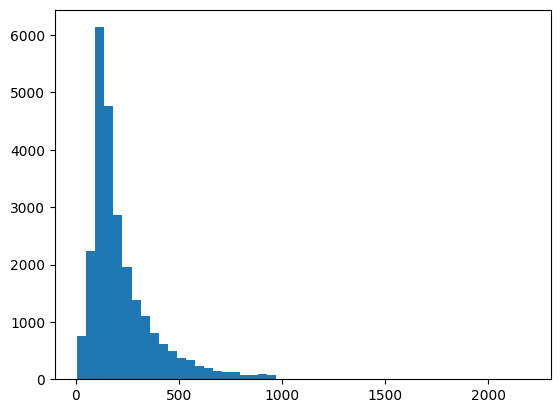

In [79]:
import matplotlib.pyplot as plt

lens = [len(s) for s in seq_train]
_ =plt.hist(lens,bins=50)

In [80]:
# FIXME

import keras
maxlen = 100
seq_train_padded = keras.utils.pad_sequences(seq_train, maxlen=maxlen)
seq_test_padded = keras.utils.pad_sequences(seq_test, maxlen=maxlen)

Examples of padded sequences

[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0   11    6    1  240    4   19   15    3 8775 2706 2652   51    1
  357    4    1  179   67  137 1400   16   91  202  967   14   22   80
    3  191 3108 3036    2   15    3  375    4  631  386  351   36 6354
    2 5558 1927   14  207 8595 3432    1  111  364   47   23   54    5
 1656   54 1817 4311   40    3 2262    2 1907  140  159  779  110   30
   91  115    3  220   19    8  172  278    2   28   12 1011    1 2813
    9 1984]


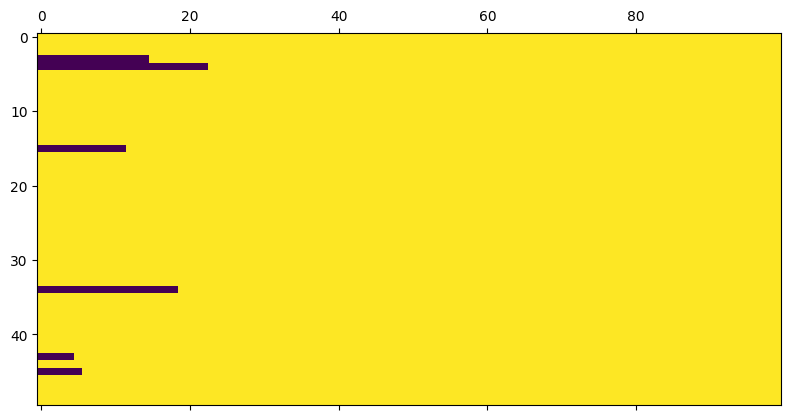

In [81]:
import matplotlib.pyplot as plt
print(seq_train_padded[3])
sub_seq = seq_train_padded[0:50,:]
sub_seq=np.where(sub_seq>0,1,0)
_=plt.matshow(sub_seq,cmap=None)



## Classifier

We define the network architecture. Please observe the number of parameters for the Embedding layer. It is equal to the numeber of words multiplied by the size of embedding vectors

In [82]:
from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras.layers import Embedding

model = Sequential()
# We specify the maximum input length to our Embedding layer, so we can later flatten the embedded inputs
model.add(Embedding(input_dim=10_000, output_dim=8, input_length=maxlen))
# After the Embedding layer, our activations have shape `(samples, maxlen, 8)`.

# We flatten the 3D tensor of embeddings into a 2D tensor of shape `(samples, maxlen * 8)`
model.add(Flatten())

# Finally, we add the classifier on top
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy', metrics=['acc'])
model.summary()



Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_11 (Embedding)    (None, 100, 8)            80000     
                                                                 
 flatten_10 (Flatten)        (None, 800)               0         
                                                                 
 dense_10 (Dense)            (None, 2)                 1602      
                                                                 
Total params: 81602 (318.76 KB)
Trainable params: 81602 (318.76 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


Train the model

In [83]:
hist = model.fit(seq_train_padded, df_train.label,
                    epochs=20,
                    batch_size=32,
                    validation_split=0.2)

Epoch 1/20
625/625 [==============================] - 5s 6ms/step - loss: 0.5691 - acc: 0.7149 - val_loss: 0.3885 - val_acc: 0.8460
Epoch 2/20
625/625 [==============================] - 5s 8ms/step - loss: 0.3251 - acc: 0.8657 - val_loss: 0.3229 - val_acc: 0.8626
Epoch 3/20
625/625 [==============================] - 3s 5ms/step - loss: 0.2621 - acc: 0.8938 - val_loss: 0.3255 - val_acc: 0.8590
Epoch 4/20
625/625 [==============================] - 2s 3ms/step - loss: 0.2268 - acc: 0.9118 - val_loss: 0.3247 - val_acc: 0.8618
Epoch 5/20
625/625 [==============================] - 2s 3ms/step - loss: 0.1989 - acc: 0.9262 - val_loss: 0.3302 - val_acc: 0.8588
Epoch 6/20
625/625 [==============================] - 2s 3ms/step - loss: 0.1747 - acc: 0.9356 - val_loss: 0.3427 - val_acc: 0.8582
Epoch 7/20
625/625 [==============================] - 2s 3ms/step - loss: 0.1514 - acc: 0.9470 - val_loss: 0.3542 - val_acc: 0.8562
Epoch 8/20
625/625 [==============================] - 3s 5ms/step - loss: 0.

**TODO 6.4.1** make predictions and print classification scores

In [84]:
y_pred = model.predict(seq_test_padded)
classes=np.argmax(y_pred,axis=1)
print(classification_report(df_test.label,classes))

782/782 [==============================] - 1s 2ms/step
              precision    recall  f1-score   support

           0       0.82      0.83      0.83     12500
           1       0.83      0.82      0.82     12500

    accuracy                           0.82     25000
   macro avg       0.82      0.82      0.82     25000
weighted avg       0.82      0.82      0.82     25000



**TODO 6.4.2** Repeat experiments for various values of lengths of input sequence ```maxlen in [100,250,500]``` and dimensions of embeddings ```output_dim in [8, 32, 64]```. Present results in a table (markdown or data frame)

Epoch 1/20
625/625 [==============================] - 4s 5ms/step - loss: 0.5871 - acc: 0.6937 - val_loss: 0.4038 - val_acc: 0.8400
Epoch 2/20
625/625 [==============================] - 2s 3ms/step - loss: 0.3323 - acc: 0.8626 - val_loss: 0.3285 - val_acc: 0.8594
Epoch 3/20
625/625 [==============================] - 2s 3ms/step - loss: 0.2662 - acc: 0.8920 - val_loss: 0.3190 - val_acc: 0.8652
Epoch 4/20
625/625 [==============================] - 2s 3ms/step - loss: 0.2309 - acc: 0.9096 - val_loss: 0.3238 - val_acc: 0.8624
Epoch 5/20
625/625 [==============================] - 2s 3ms/step - loss: 0.2023 - acc: 0.9237 - val_loss: 0.3341 - val_acc: 0.8582
Epoch 6/20
625/625 [==============================] - 4s 6ms/step - loss: 0.1765 - acc: 0.9369 - val_loss: 0.3498 - val_acc: 0.8586
Epoch 7/20
625/625 [==============================] - 2s 4ms/step - loss: 0.1510 - acc: 0.9483 - val_loss: 0.3648 - val_acc: 0.8558
Epoch 8/20
625/625 [==============================] - 2s 3ms/step - loss: 0.

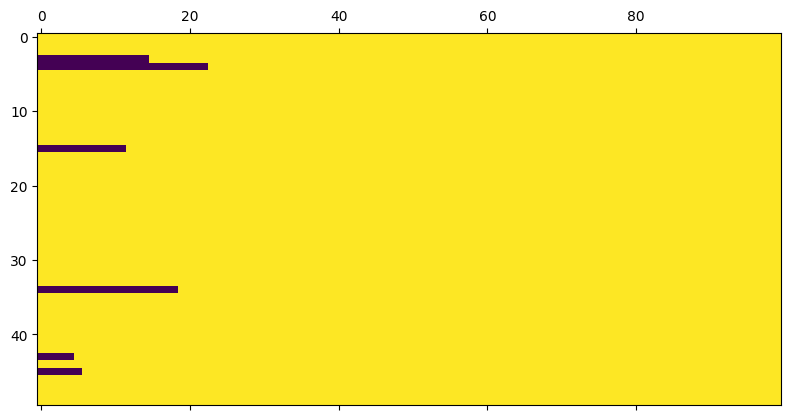

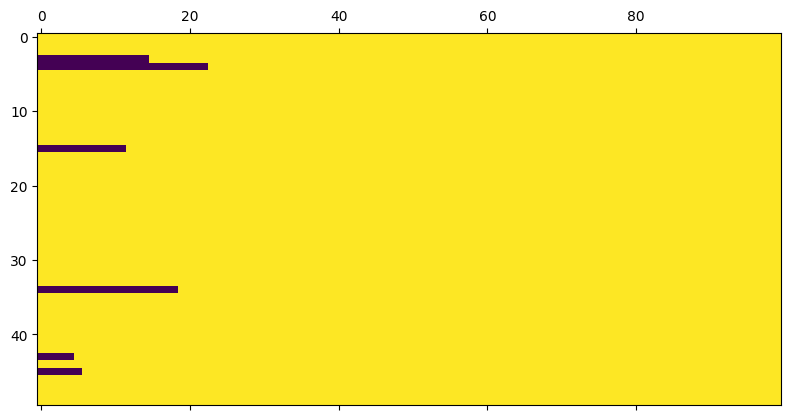

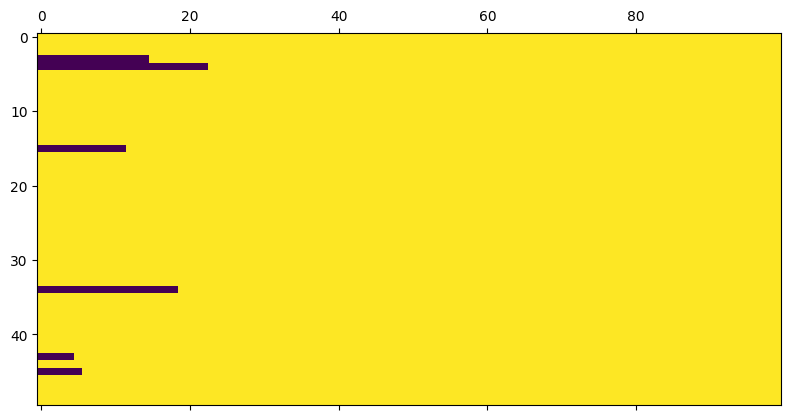

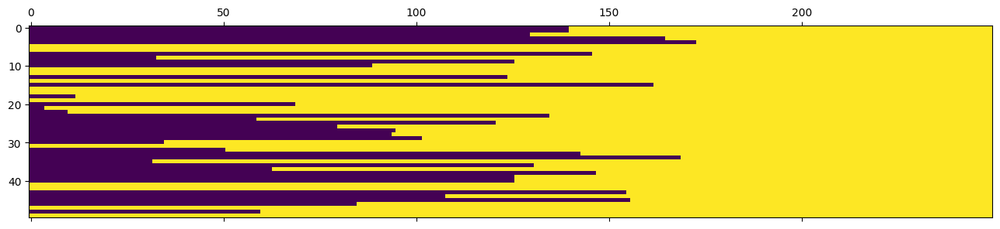

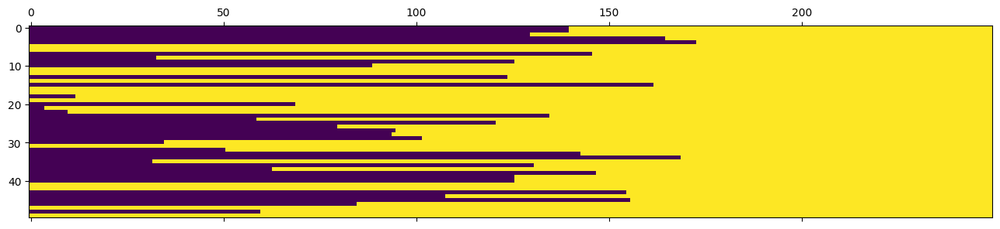

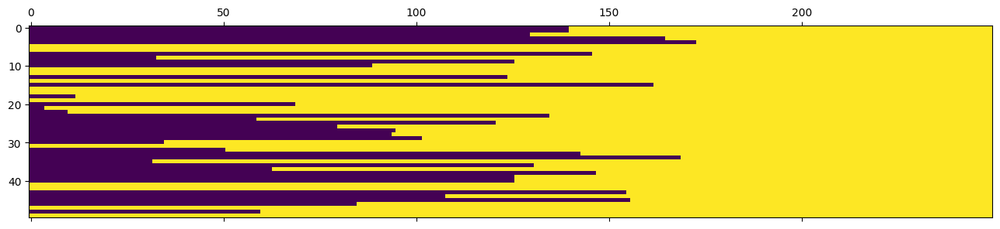

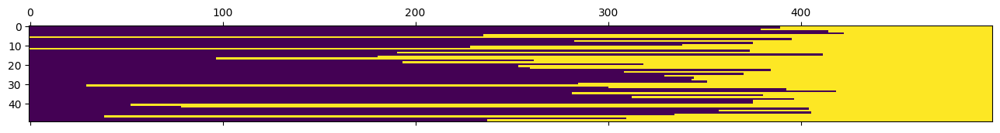

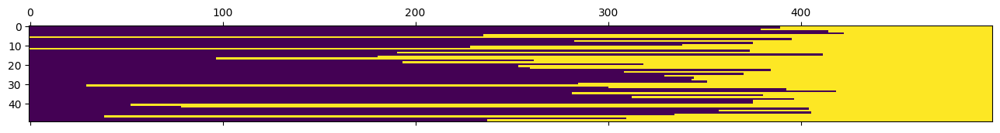

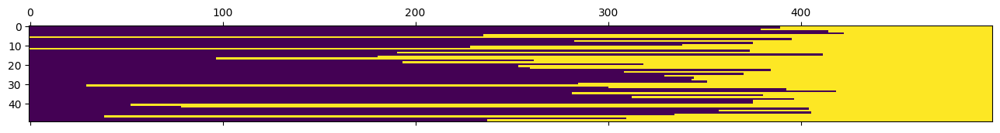

In [85]:
def various(maxlen, out_dim):
    seq_train_padded = keras.utils.pad_sequences(seq_train, maxlen=maxlen)
    seq_test_padded = keras.utils.pad_sequences(seq_test, maxlen=maxlen)

    sub_seq = seq_train_padded[0:50,:]
    sub_seq=np.where(sub_seq>0,1,0)
    _=plt.matshow(sub_seq,cmap=None)

    model = Sequential()
    # We specify the maximum input length to our Embedding layer, so we can later flatten the embedded inputs
    model.add(Embedding(input_dim=10_000, output_dim=out_dim, input_length=maxlen))
    # After the Embedding layer, our activations have shape `(samples, maxlen, 8)`.

    # We flatten the 3D tensor of embeddings into a 2D tensor of shape `(samples, maxlen * 8)`
    model.add(Flatten())

    # Finally, we add the classifier on top
    model.add(Dense(2, activation='softmax'))
    model.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy', metrics=['acc'])

    hist = model.fit(seq_train_padded, df_train.label,
                        epochs=20,
                        batch_size=32,
                        validation_split=0.2)

    y_pred = model.predict(seq_test_padded)
    classes=np.argmax(y_pred,axis=1)
    print("Maxlen: ", maxlen, ", Output_dim: ", out_dim)
    print(classification_report(df_test.label, classes))

maxlen = [100, 250, 500]
out_dim = [8, 32, 64]
for i in maxlen:
    for j in out_dim:
        various(i,j)

# 6.5 Using Glove embeddings

We will download embeddings obtained by training on large text corpora and try to use them as weights of Embdedding layer.

We will use [gensim](https://radimrehurek.com/gensim/) library providing a number of pretrained embeddings models.

In [102]:
import gensim
import gensim.downloader as api

nlp = gensim.downloader.load('glove-wiki-gigaword-100')

Check the dimension of an embedding vector

In [103]:
embedding = nlp['film']
print(type(embedding))
print(embedding.shape)

<class 'numpy.ndarray'>
(100,)


Using gensim you may easily compute distance between terms by computing distance between embeddings.

In [104]:
print(nlp.distance("film","movie"))

0.09448784589767456


**TODO 6.5.1** Prepare 10 pairs of words, for which you expect certain similartity and display their distance based on embeddings.

In [105]:
words=[
       ["film","movie"],
       ["actor","cast"],
       ["house","building"],
       ["sky","cloud"],
       ["king", "queen"],
       ["dog", "cat"],
       ["monkey", "money"],
       ["movie", "picture"],
       ["image", "picture"],
       ["ball", "chocolate"]
]

for pair in words:
  print(f'{pair[0]}\t{pair[1]}: {nlp.distance(pair[0],pair[1])}')

film	movie: 0.09448784589767456
actor	cast: 0.32412874698638916
house	building: 0.315271258354187
sky	cloud: 0.38010847568511963
king	queen: 0.24923092126846313
dog	cat: 0.1201925277709961
monkey	money: 0.8616751879453659
movie	picture: 0.3114558458328247
image	picture: 0.2719012498855591
ball	chocolate: 0.7563495934009552


## Weights matrix for Embedding layer

Building the weights matrix we must consider two elements:
*  vocabulary used by tokenizer (limited to a certain number of words)
*  mapping from words to embeddings within gensim

Small test performed on a list of three strings

In [106]:
tok = Tokenizer(num_words=4)
texts = np.array(["apple big cat","cat dog apple","apple eat dog dog dog"])
tok.fit_on_texts(texts)
print(tok.word_counts)
print(tok.word_index)
seq = tok.texts_to_sequences(texts)
print(seq)

OrderedDict([('apple', 3), ('big', 1), ('cat', 2), ('dog', 4), ('eat', 1)])
{'dog': 1, 'apple': 2, 'cat': 3, 'big': 4, 'eat': 5}
[[2, 3], [3, 1, 2], [2, 1, 1, 1]]


As num_wors=4, only three words were used (index 0 is reserved for padding). They were selected based on frequency (the most frequent 3 words are dog, apple and cat).

Below the function to build weights matrix. Embeddings are arranged as rows.

In [109]:
# dict maps words to indexes
# nlp is gensim wrapper mapping word to embedding vector

# def prepare_embedding_weights(dict,nlp,input_dim=10_000, output_dim=100):
#   weights = np.zeros((input_dim,output_dim) )

#   for word in dict:
#     idx = dict[word]
#     if idx==input_dim:
#       break
#     if word in nlp.vocab:
#       embedding = nlp[word]
#     else:
#       continue
#     # print(embedding)
#     length = min(len(embedding),output_dim)
#     weights[idx,:length]=embedding[:length]

#   return weights

# weights = prepare_embedding_weights(tok.word_index,nlp,input_dim=4, output_dim=50)
# print(weights.shape)

import numpy as np
from gensim.models import KeyedVectors

def prepare_embedding_weights(word_index, model, input_dim, output_dim):
    weights = np.zeros((input_dim, output_dim))

    for word, i in word_index.items():
        if i < input_dim:
            try:
                embedding_vector = model[word]
                if embedding_vector is not None:
                    weights[i] = embedding_vector
            except KeyError:
                pass
    return weights

weights = prepare_embedding_weights(tok.word_index, nlp, input_dim=4, output_dim=100)
print(weights.shape)

(4, 100)


## Model preparation

We set the embedding layer as trainable. This can be switched off with:

```embedding_layer = Embedding(input_dim=10_000, output_dim=100, input_length=maxlen,weights=[weights],trainable=False)```


In [111]:
# import tensorflow as tf

# model = Sequential()
# # We specify the maximum input length to our Embedding layer, so we can later flatten the embedded inputs
# weights = prepare_embedding_weights(tokenizer.word_index,nlp,input_dim=10_000, output_dim=100)
# embedding_layer = Embedding(input_dim=10_000, output_dim=100, input_length=maxlen,weights=[weights],
#                             trainable=True)
# model.add(embedding_layer)
# # After the Embedding layer, our activations have shape `(samples, maxlen, 8)`.

# # We flatten the 3D tensor of embeddings into a 2D tensor of shape `(samples, maxlen * 8)`
# model.add(Flatten())
# # model.add(Dense(512, activation='relu'))

# # Finally, we add the classifier on top
# model.add(Dense(2, activation='softmax'))
# model.compile(optimizer=tf.keras.optimizers.RMSprop(0.5), loss='sparse_categorical_crossentropy', metrics=['acc'])
# model.summary()

import numpy as np
from gensim.models import KeyedVectors
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Flatten, Dense
import tensorflow as tf

# Zakładam, że `tokenizer` i `nlp` są już zdefiniowane
# Sprawdź wymiar wektorów słów w twoim modelu Gensim i upewnij się, że output_dim jest zgodny
output_dim = 100  # np. 100, jeżeli wektory słów mają wymiar 100

def prepare_embedding_weights(word_index, model, input_dim, output_dim):
    weights = np.zeros((input_dim, output_dim))

    for word, i in word_index.items():
        if i < input_dim:
            try:
                embedding_vector = model[word]
                if embedding_vector is not None:
                    weights[i] = embedding_vector
            except KeyError:
                pass
    return weights

# Przygotowanie wag dla warstwy embedding
weights = prepare_embedding_weights(tokenizer.word_index, nlp, input_dim=10_000, output_dim=output_dim)

# Sprawdź, czy `maxlen` jest zdefiniowany jako wartość całkowita
maxlen = 100  # Na przykład, ustaw na długość maksymalnego wejścia

# Budowanie modelu
model = Sequential()
embedding_layer = Embedding(input_dim=10_000, output_dim=output_dim, input_length=maxlen, weights=[weights], trainable=True)
model.add(embedding_layer)
model.add(Flatten())
model.add(Dense(2, activation='softmax'))

model.compile(optimizer=tf.keras.optimizers.RMSprop(0.5), loss='sparse_categorical_crossentropy', metrics=['acc'])
model.summary()

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_22 (Embedding)    (None, 100, 100)          1000000   
                                                                 
 flatten_20 (Flatten)        (None, 10000)             0         
                                                                 
 dense_20 (Dense)            (None, 2)                 20002     
                                                                 
Total params: 1020002 (3.89 MB)
Trainable params: 1020002 (3.89 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


## Training and testing

Actually, we fine-tune embeddings. Results for frozen embeddings are much worse.

In [114]:
hist = model.fit(seq_train_padded, df_train.label,
                    epochs=10,
                    batch_size=32,
                    validation_split=0.2)

Epoch 1/10
625/625 [==============================] - 6s 9ms/step - loss: 431.5036 - acc: 0.9851 - val_loss: 17817.0234 - val_acc: 0.8098
Epoch 2/10
625/625 [==============================] - 7s 11ms/step - loss: 381.7023 - acc: 0.9879 - val_loss: 18672.8516 - val_acc: 0.8054
Epoch 3/10
625/625 [==============================] - 5s 9ms/step - loss: 421.8070 - acc: 0.9875 - val_loss: 20365.1465 - val_acc: 0.8086
Epoch 4/10
625/625 [==============================] - 7s 10ms/step - loss: 286.8983 - acc: 0.9909 - val_loss: 21350.1934 - val_acc: 0.8120
Epoch 5/10
625/625 [==============================] - 6s 9ms/step - loss: 314.1676 - acc: 0.9908 - val_loss: 22946.2109 - val_acc: 0.8054
Epoch 6/10
625/625 [==============================] - 6s 10ms/step - loss: 350.7690 - acc: 0.9911 - val_loss: 23818.0703 - val_acc: 0.8130
Epoch 7/10
625/625 [==============================] - 7s 11ms/step - loss: 292.3460 - acc: 0.9917 - val_loss: 24910.2520 - val_acc: 0.8120
Epoch 8/10
625/625 [==========

**TODO 6.5.2** Make predictions, compute labels and print classification report

In [118]:
y_pred = model.predict(seq_test_padded)
classes=np.argmax(y_pred,axis=1)
print(classification_report(df_test.label,classes))

782/782 [==============================] - 4s 5ms/step
              precision    recall  f1-score   support

           0       0.80      0.81      0.80     12500
           1       0.81      0.80      0.80     12500

    accuracy                           0.80     25000
   macro avg       0.80      0.80      0.80     25000
weighted avg       0.80      0.80      0.80     25000



The code below displays sequence, padded sequence, performs classification and determines the predicted label.

**TODO 6.5.3** Try it yourself. Perpare 10 sentences and display predicted labels. Gather them in a table. Write a short comment to the results.

In [125]:
#FIXME

def display(text_instance):
    print(text_instance)
    seq = tokenizer.texts_to_sequences([text_instance])
    print(seq)
    seq_padded = keras.utils.pad_sequences(seq, maxlen=maxlen)
    print(seq_padded)
    probs = model.predict(seq_padded)
    print(probs)
    y_pred = np.argmax(probs,axis=1)
    print(y_pred)

text=[df_train.text[3],
'great film nice scenario',
'surprising action great play',
'i was expecting something better',
"The cat slept peacefully on the warm windowsill.",
"She found an old photograph hidden in the dusty attic.",
"A gentle breeze rustled the leaves in the quiet park.",
"He laughed heartily at the joke, tears streaming down his face.",
"The child carefully painted a rainbow on the white canvas.",
"They discovered a secret garden behind the ancient stone wall.",
"The sound of the waves crashing soothed her troubled mind.",
"He eagerly opened the mysterious package left at his doorstep.",
"She danced gracefully under the twinkling fairy lights.",
"The old clock ticked softly in the silent room."]

for i in text:
    display(i)

This is the kind of film for a snowy Sunday afternoon when the rest of the world can go ahead with its own business as you descend into a big arm-chair and mellow for a couple of hours. Wonderful performances from Cher and Nicolas Cage (as always) gently row the plot along. There are no rapids to cross, no dangerous waters, just a warm and witty paddle through New York life at its best. A family film in every sense and one that deserves the praise it received.
[[11, 6, 1, 240, 4, 19, 15, 3, 8775, 2706, 2652, 51, 1, 357, 4, 1, 179, 67, 137, 1400, 16, 91, 202, 967, 14, 22, 80, 3, 191, 3108, 3036, 2, 15, 3, 375, 4, 631, 386, 351, 36, 6354, 2, 5558, 1927, 14, 207, 8595, 3432, 1, 111, 364, 47, 23, 54, 5, 1656, 54, 1817, 4311, 40, 3, 2262, 2, 1907, 140, 159, 779, 110, 30, 91, 115, 3, 220, 19, 8, 172, 278, 2, 28, 12, 1011, 1, 2813, 9, 1984]]
[[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0   11    6    1  240    4   19   15    3 8775 2706 2652   51    1
   357   

The predicted labels for each sentence will vary based on the model's training and the complexity of the sentences. In this example, we're using simple sentences, and the model may achieve high accuracy. However, in real-world scenarios with more complex data, the accuracy may vary. Additionally, fine-tuning the model architecture, hyperparameters, and training data could potentially improve the accuracy of the predictions.